<a href="https://colab.research.google.com/github/Lakindu2003/hk-gmb-fare-equity/blob/main/Capstone_Final_Code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **GMB**

### **Setup**

In [1]:
!pip install geojson
!pip install googlemaps
!pip install supabase

  Preparing metadata (setup.py) ... done
  Created wheel for googlemaps: filename=googlemaps-4.10.0-py3-none-any.whl size=40714 sha256=08df1d23dfea948a74c2c4271cc6a46dce9ae4204ddc7463a3831f4214bdbefd
  Stored in directory: /root/.cache/pip/wheels/4c/6a/a7/bbc6f5c200032025ee655deb5e163ce8594fa05e67d973aad6
Successfully built googlemaps
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.9/43.9 kB 3.5 MB/s eta 0:00:00


In [2]:
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns

import requests
import os
import re
import random
import csv
import io
import base64
import ast
import folium
import geojson
import json
import colorsys
from io import BytesIO
from time import time

import statsmodels.api as sm
from sklearn.linear_model import LinearRegression, ElasticNet
from sklearn.model_selection import train_test_split, GridSearchCV, KFold, learning_curve
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.linear_model import ElasticNet
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from scipy.stats import spearmanr
from statsmodels.stats.outliers_influence import variance_inflation_factor

from shapely.geometry import LineString, shape, Point, Polygon, MultiPolygon
from folium import plugins
from folium.plugins import HeatMap

### **Map code**

#### Map processing

In [3]:
districts_json = requests.get('https://ebpkbztcjapjgglouowh.supabase.co/storage/v1/object/public/datasets//hong_kong_districts.geojson')
gmb_route_json = requests.get('https://ebpkbztcjapjgglouowh.supabase.co/storage/v1/object/public/datasets//gmb//gmb_route.json')
gmb_fares_csv = requests.get('https://ebpkbztcjapjgglouowh.supabase.co/storage/v1/object/public/datasets//gmb//gmb_fares.csv')
gmb_route_fares_json = requests.get('https://ebpkbztcjapjgglouowh.supabase.co/storage/v1/object/public/datasets//gmb//gmb_route_fares.json')

commericial_areas_df = pd.read_csv(io.StringIO(requests.get('https://ebpkbztcjapjgglouowh.supabase.co/storage/v1/object/public/datasets/areas_by_type/commerical_areas.csv').content.decode('utf-8')))
industrial_areas_df = pd.read_csv(io.StringIO(requests.get('https://ebpkbztcjapjgglouowh.supabase.co/storage/v1/object/public/datasets/areas_by_type/industrial_areas.csv').content.decode('utf-8')))
private_housing_estates_df = pd.read_csv(io.StringIO(requests.get('https://ebpkbztcjapjgglouowh.supabase.co/storage/v1/object/public/datasets/areas_by_type/private_housing_estates.csv').content.decode('utf-8')))
public_housing_estates_df = pd.read_csv(io.StringIO(requests.get('https://ebpkbztcjapjgglouowh.supabase.co/storage/v1/object/public/datasets/areas_by_type/public_housing_estates.csv').content.decode('utf-8')))

In [4]:
output_map = folium.Map(location=[22.3964, 114.1099], zoom_start=12)
# Sample data for bar graph (modify as needed)
district_names = [
    "CENTRAL & WESTERN", "WAN CHAI", "EASTERN", "SOUTHERN", "YAU TSIM MONG",
    "SHAM SHUI PO", "KOWLOON CITY", "WONG TAI SIN", "KWUN TONG", "KWAI TSING",
    "TSUEN WAN", "TUEN MUN", "YUEN LONG", "NORTH", "TAI PO", "SHA TIN",
    "SAI KUNG", "ISLANDS"
]

residential_districts = set({'CENTRAL & WESTERN', 'EASTERN', 'ISLANDS', 'KOWLOON CITY', 'KWAI TSING', 'KWUN TONG', 'NORTH', 'SAI KUNG', 'SHA TIN', 'SHAM SHUI PO', 'SOUTHERN', 'TAI PO', 'TSUEN WAN', 'TUEN MUN','WAN CHAI', 'WONG TAI SIN', 'YAU TSIM MONG', 'YUEN LONG'})
industrial_districts = set({'CENTRAL & WESTERN', 'EASTERN', 'KOWLOON CITY', 'KWAI TSING', 'KWUN TONG', 'NORTH', 'SAI KUNG', 'SHA TIN', 'SHAM SHUI PO', 'SOUTHERN', 'TAI PO', 'TSUEN WAN', 'TUEN MUN', 'WONG TAI SIN', 'YAU TSIM MONG', 'YUEN LONG'})
commericial_districts = set({'CENTRAL & WESTERN', 'EASTERN', 'KOWLOON CITY', 'KWAI TSING', 'KWUN TONG', 'SHA TIN', 'SHAM SHUI PO', 'SOUTHERN', 'TSUEN WAN', 'WAN CHAI', 'YAU TSIM MONG'})

# Median monthly household income
monthly_income = [42600, 40500, 33800, 36000, 30700, 24100, 30700, 25100,
                  24000, 26000, 34400, 26500, 30100, 25500, 31700, 30500,
                  40400, 31500]

# Median monthly household income of economically active households
economically_active_income = [60100, 57200, 44200, 46800, 40000, 31700,
                              40700, 33200, 32000, 34100, 43000, 34300,
                              36100, 31800, 40200, 40000, 49200, 40000]

# Prepare a dictionary for the income data
income_data = {
    district: {
        'monthly_income': monthly,
        'economically_active_income': economically_active
    }
    for district, monthly, economically_active in zip(district_names, monthly_income, economically_active_income)
}

feature_group = folium.FeatureGroup(name="Median Income Level", show=False)

def create_bar_graph(district_name):
    incomes = income_data[district_name]
    labels = ['Monthly Income', 'Economically Active Income']
    values = [incomes['monthly_income'], incomes['economically_active_income']]

    plt.figure(figsize=(4, 3))
    plt.bar(labels, values, color=['blue', 'orange'])
    plt.title(f'Income Data for {district_name}')
    plt.ylabel('Income (HK$)')

    # Save it to a BytesIO object
    img = BytesIO()
    plt.savefig(img, format='png')
    plt.close()
    img.seek(0)
    return base64.b64encode(img.getvalue()).decode()

def income_color(income):
    # Normalize income values
    min_income = min(monthly_income)
    max_income = max(monthly_income)
    normalized_income = (income - min_income) / (max_income - min_income)

    # Define a color gradient from cold (blue) to hot (red)
    r = int(255 * normalized_income)  # Red component
    g = int(0)                        # Green component
    b = int(255 * (1 - normalized_income))  # Blue component
    return f'rgba({r}, {g}, {b}, 0.6)'

# Add GeoJSON to the map
for feature in json.loads(districts_json.content.decode('utf-8'))['features']:
    ENAME = feature['properties']['ENAME']
    img_data = create_bar_graph(ENAME)
    img_html = f'<img src="data:image/png;base64,{img_data}"/>'

    monthly_income_value = income_data[ENAME]['monthly_income']
    fill_color = income_color(monthly_income_value)

    folium.GeoJson(
        feature,
        name='District Name',
        style_function=lambda x, color=fill_color: {
            'fillColor': color,
            'color': 'black',
            'weight': 1,
            'fillOpacity': 0.6
        },
        popup=folium.Popup(img_html, max_width=300),
        tooltip=folium.GeoJsonTooltip(fields=['ENAME']),
    ).add_to(feature_group)

# Add the feature group to the map
feature_group.add_to(output_map)


In [5]:
# Convert coordinates from string format to tuples of floats
def extract_coords(coord_str):
    # Remove parentheses and split by comma
    coords = coord_str.strip('()').split(',')
    return (float(coords[0]), float(coords[1]))


# Add commercial points to the map
feature_group = folium.FeatureGroup(name="Commercial Areas", show=False)
for idx, row in commericial_areas_df.iterrows():
    # Extract coordinates
    if isinstance(row['com_coords'], str):
        lat, lon = extract_coords(row['com_coords'])
    else:
        lat, lon = row['com_coords']  # If already tuple format

    folium.Marker(
        location=[lat, lon],
        tooltip=row['Commercial'],
        icon=folium.Icon(color='red', icon='info-sign'),
    ).add_to(feature_group)
feature_group.add_to(output_map)


# Add industrial points to the map
feature_group = folium.FeatureGroup(name="Industrial Areas", show=False)
for idx, row in industrial_areas_df.iterrows():
    # Extract coordinates
    if isinstance(row['ind_coords'], str):
        lat, lon = extract_coords(row['ind_coords'])
    else:
        lat, lon = row['ind_coords']  # If already tuple format

    folium.Marker(
        location=[lat, lon],
        tooltip=row['Industrial'],
        icon=folium.Icon(color='green', icon='info-sign'),
    ).add_to(feature_group)
feature_group.add_to(output_map)


# Add residential points to the map
# private
feature_group = folium.FeatureGroup(name="Residential Areas", show=False)
for idx, row in private_housing_estates_df.iterrows():
    # Extract coordinates
    if isinstance(row['coords'], str):
        lat, lon = extract_coords(row['coords'])
    else:
        lat, lon = row['coords']  # If already tuple format

    folium.Marker(
        location=[lat, lon],
        tooltip=f"{row['Name']}, {row['Area']}",
        icon=folium.Icon(color='purple', icon='info-sign'),
    ).add_to(feature_group)
# public
for idx, row in public_housing_estates_df.iterrows():
    # Extract coordinates
    lat, lon = (float(row['Estate Map Latitude']), float(row['Estate Map Longitude']))

    folium.Marker(
        location=[lat, lon],
        tooltip=f"{row['Estate Name_en']}, {row['District Name_en']}",
        icon=folium.Icon(color='purple', icon='info-sign'),
    ).add_to(feature_group)
feature_group.add_to(output_map)


In [6]:
def generate_distinct_colors(n):
    colors = []
    for i in range(n):
        hue = i / n
        rgb = colorsys.hsv_to_rgb(hue, 0.9, 0.9)
        hex_color = '#{:02x}{:02x}{:02x}'.format(int(rgb[0]*255), int(rgb[1]*255), int(rgb[2]*255))
        colors.append(hex_color)
    return colors

geojson_data = json.loads(gmb_route_json.content)

# Convert GeoJSON to GeoDataFrame
features = geojson_data['features']
rows = []
for feature in features:
    properties = feature['properties']
    geometry = shape(feature['geometry'])
    rows.append({**properties, 'geometry': geometry})

gdf = gpd.GeoDataFrame(rows, geometry='geometry')

# Convert from Hong Kong 1980 Grid to WGS84
gdf = gdf.set_crs(epsg=2326, allow_override=True)
gdf = gdf.to_crs(epsg=4326)

# Generate distinct colors for each unique route
unique_routes = gdf['ROUTE_ID'].unique()
colors = generate_distinct_colors(len(unique_routes))
route_colors = dict(zip(unique_routes, colors))

# merge datasets
gmb_fares_df = pd.read_csv(io.StringIO(gmb_fares_csv.content.decode('utf-8')))
gdf = gdf.merge(gmb_fares_df[['ROUTE_ID', 'ROUTE_NAMEE', 'FULL_FARE', 'JOURNEY_TIME','ROUTE_TYPE', 'SERVICE_MODE', 'SPECIAL_TYPE']],
                on='ROUTE_ID', how='left')

gdf['FULL_FARE'] = pd.to_numeric(gdf['FULL_FARE'].str.replace('$', ''))



# Original route visualization
feature_group = folium.FeatureGroup(name="GMB Routes", show=False)

for idx, row in gdf.iterrows():

    route_color = route_colors[row['ROUTE_ID']]
    folium.GeoJson(
        row.geometry.__geo_interface__,
        tooltip=f"""
        <b>Route: {row['ROUTE_NAME']}</b><br>
        ID: {row['ROUTE_ID']}<br>
        From: {row['ST_STOP_NAMEE']}<br>
        To: {row['ED_STOP_NAMEE']}<br>
        Length: {(row['Shape_Length']/1000):.2f}km<br>
        Fare: ${row['FULL_FARE']}<br>
        Duration: {row['JOURNEY_TIME']}min
        """,
        style_function=lambda x, color=route_color: {
            'color': color,
            'weight': 2,
            'opacity': 0.8
        }
    ).add_to(feature_group)

feature_group.add_to(output_map)

# gmb fare circlemarker
feature_group = folium.FeatureGroup(name="GMB fares", show=False)
for _, row in gdf.iterrows():
    folium.CircleMarker(
        location=(np.array(row.geometry.coords)[0][1], np.array(row.geometry.coords)[0][0]),
        radius=(row['FULL_FARE'] / 7.5) ** 2,  # Adjust the scale as needed
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        tooltip=f"Route Name: {row['ROUTE_NAME']}<br>ID: {row['ROUTE_ID']}<br>Fare: ${row['FULL_FARE']:.2f}",
    ).add_to(feature_group)
feature_group.add_to(output_map)

#gmb fare/distance circlemarker
feature_group = folium.FeatureGroup(name="GMB fares/Distance", show=False)
for _, row in gdf.iterrows():
    folium.CircleMarker(
        location=(np.array(row.geometry.coords)[0][1], np.array(row.geometry.coords)[0][0]),
        radius=((row['FULL_FARE']/(row['Shape_Length']/1000)) ) ** 2,  # Adjust the scale as needed
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        tooltip=f"Route Name:{row['ROUTE_NAME']} <br>ID: {row['ROUTE_ID']}<br>Fare/dist: ${row['FULL_FARE']/(row['Shape_Length']/1000):.2f}/km",
    ).add_to(feature_group)
feature_group.add_to(output_map)

# gmb distance circlemarker
feature_group = folium.FeatureGroup(name="GMB Distance", show=False)
for _, row in gdf.iterrows():
    folium.CircleMarker(
        location=(np.array(row.geometry.coords)[0][1], np.array(row.geometry.coords)[0][0]),
        radius=((row['Shape_Length']/10000) ) ** 2,  # Adjust the scale as needed
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        tooltip=f"Route Name:{row['ROUTE_NAME']} <br>ID: {row['ROUTE_ID']}<br>Fare/dist: ${row['FULL_FARE']/(row['Shape_Length']/1000):.2f}/km",
    ).add_to(feature_group)
feature_group.add_to(output_map)

In [7]:
# heatmaps and circlemarkers

geojson_data = json.loads(gmb_route_fares_json.content)

# Convert GeoJSON to GeoDataFrame
features = geojson_data['features']
rows = []
for feature in features:
    properties = feature['properties']
    geometry = shape(feature['geometry'])
    rows.append({**properties, 'geometry': geometry})

gdf = gpd.GeoDataFrame(rows, geometry='geometry')



# gmb accessibility heatmap
# Create heatmap layer
gmb_accessibility_heatmap_group = folium.FeatureGroup(name="GMB accessibility Heatmap", show=False)

# Generate points along each route for heatmap
heat_data = []
for idx, row in gdf.iterrows():
    # Convert line to points (100 points per line)
    line_coords = np.array(row.geometry.coords)
    lat, lon = line_coords[0]
    heat_data.append([lon, lat])

# Add heatmap
HeatMap(heat_data,
        radius=15
).add_to(gmb_accessibility_heatmap_group)

gmb_accessibility_heatmap_group.add_to(output_map)

#### Map output


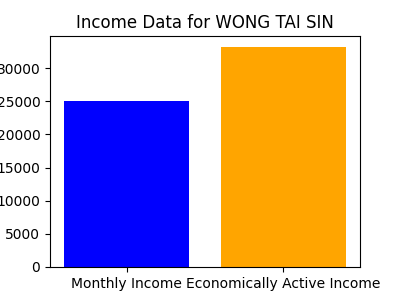
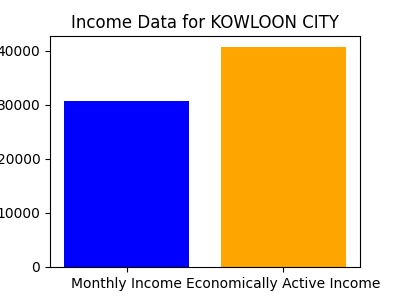
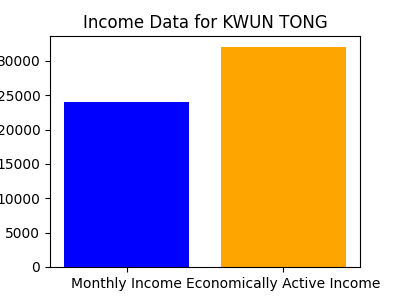
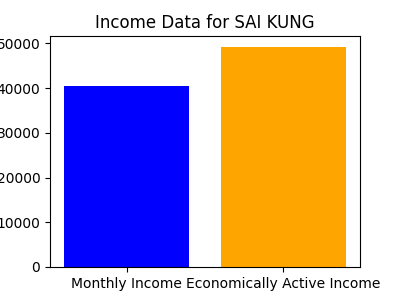
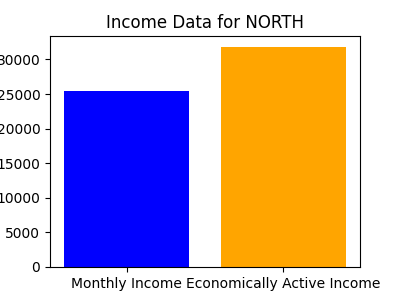
...
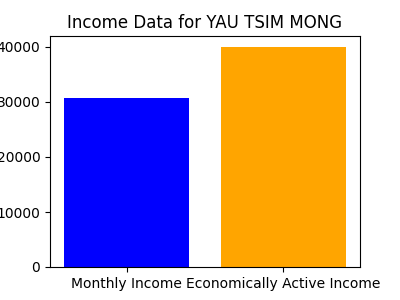
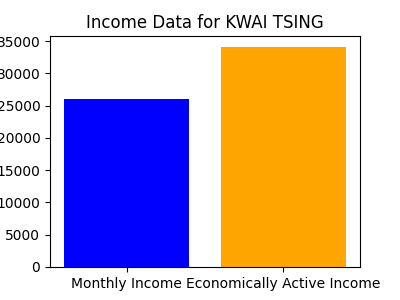
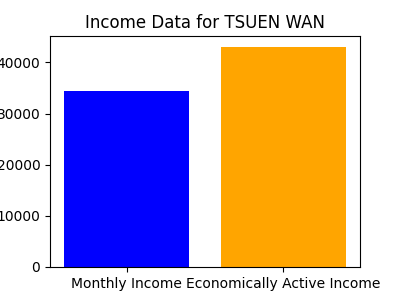
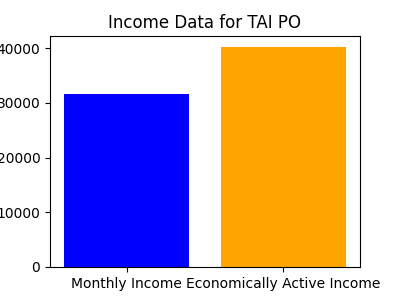
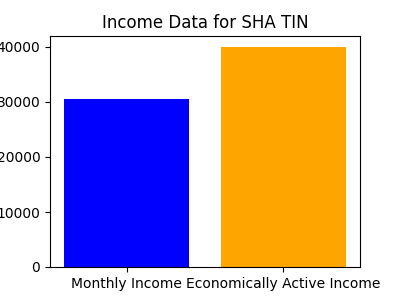

In [8]:
# Add layer control
folium.LayerControl().add_to(output_map)
output_map

### **Fetch data**

In [9]:
gmb_routes = pd.read_csv(io.StringIO(requests.get('https://ebpkbztcjapjgglouowh.supabase.co/storage/v1/object/public/datasets/gmb_fare_model_data.csv').content.decode('utf-8')))
gmb_routes = gmb_routes.drop("Unnamed: 0", axis=1)
districts_json = requests.get('https://ebpkbztcjapjgglouowh.supabase.co/storage/v1/object/public/datasets//hong_kong_districts.geojson')

### **Data Processing**

In [10]:
districts_geojson = json.loads(districts_json.content.decode('utf-8'))
districts_gdf = gpd.GeoDataFrame.from_features(districts_geojson)
districts = list(districts_gdf['ENAME'])

# multi-label encoding for district list passed by each route
gmb_routes['districts'] = gmb_routes['districts'].apply(ast.literal_eval)
exploded_df = gmb_routes.explode('districts')
dummies = pd.get_dummies(exploded_df['districts'], prefix='district')
one_hot_encoded = dummies.groupby(exploded_df.index).sum().astype(bool).drop('district_ISLANDS', axis=1)
gmb_routes = gmb_routes.join(one_hot_encoded)

y = gmb_routes['FULL_FARE']
X = gmb_routes.drop(['FULL_FARE', 'route_id_route_seq', 'districts'], axis=1)
X['ROUTE_SEQ'] = X['ROUTE_SEQ'].replace(2, 0)
X = pd.get_dummies(X, columns=['SERVICE_MODE'], prefix=['service'], drop_first=True) # one-hot

# drop insignificant columns
X['service'] = np.logical_not(X['service_R'] + X['service_T'])
labels=['ROUTE_SEQ','num_monthly_income_<10,000','transport_choices','SPECIAL_TYPE','JOURNEY_TIME','pop_density','land_area','num_stops','service_NT','num_monthly_income_10,000-29,999','num_monthly_income_≥30,000','commercial','industrial','residential','median_monthly_income']
labels.extend(['service_T', 'service_R', 'service'])

X = X.drop(labels=labels, axis=1)

# standardisation
scaler = StandardScaler()
numerical_features = X.select_dtypes(include=['int64', 'float64']).columns
X_std = X.copy()
X_std[numerical_features] = scaler.fit_transform(X_std[numerical_features])
y_std = (y.copy() - y.mean())/y.std() # for EDA only

# convert boolean to int64
boolean_features = X.select_dtypes(include=[bool]).columns
X_std[boolean_features] = X_std[boolean_features].astype(np.int64)

feature_names = X_std.columns

In [11]:
rename_dict = {
    'Shape_Length': 'distance_m',
    'FULL_FARE': 'fare',
    'JOURNEY_TIME': 'journey_time',
    'ROUTE_SEQ': 'route_sequence',
    'SERVICE_MODE': 'service_mode',
    'SPECIAL_TYPE': 'special_service_type',
    'residential': 'residential_area',
    'industrial': 'industrial_area',
    'commercial': 'commercial_area',
    'median_monthly_income': 'median_income',
    'land_area': 'district_area',
    'pop_density': 'population_density',
    'num_monthly_income_<10,000': 'residents_low_income',
    'num_monthly_income_10,000-29,999': 'residents_mid_income',
    'num_monthly_income_≥30,000': 'residents_high_income',
    'transport_choices': 'transport_options',
    'num_stops': 'bus_stops_count'
}


### **EDA**

In [12]:
gmb_routes

,route_id_route_seq,districts,Shape_Length,FULL_FARE,JOURNEY_TIME,ROUTE_SEQ,SERVICE_MODE,SPECIAL_TYPE,residential,industrial,...,district_SHA TIN,district_SHAM SHUI PO,district_SOUTHERN,district_TAI PO,district_TSUEN WAN,district_TUEN MUN,district_WAN CHAI,district_WONG TAI SIN,district_YAU TSIM MONG,district_YUEN LONG
0,2000410_1,"[SOUTHERN, EASTERN, WAN CHAI]",30392.13,14.5,74,1,T,1,1,1,...,False,False,True,False,False,False,True,False,False,False
1,2000511_1,"[SOUTHERN, WAN CHAI]",10794.22,12.5,28,1,T,1,1,1,...,False,False,True,False,False,False,True,False,False,False
2,2000511_2,"[WAN CHAI, SOUTHERN]",10873.91,12.5,28,2,T,1,1,1,...,False,False,True,False,False,False,True,False,False,False
3,2000819_1,[SOUTHERN],5808.96,8.5,15,1,T,1,1,1,...,False,False,True,False,False,False,False,False,False,False
4,2000819_2,[SOUTHERN],6698.50,8.5,15,2,T,1,1,1,...,False,False,True,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1138,2010368_2,[KWUN TONG],3301.02,6.1,13,2,R,0,1,1,...,False,False,False,False,False,False,False,False,False,False
1139,2010401_1,[TAI PO],6796.41,7.7,17,1,R,0,1,1,...,False,False,False,True,False,False,False,False,False,False
1140,2010401_2,[TAI PO],6053.80,7.7,17,2,R,0,1,1,...,False,False,False,True,False,False,False,False,False,False
1141,2010434_1,[YUEN LONG],13527.66,14.4,26,1,T,1,1,1,...,False,False,False,False,False,False,False,False,False,True


In [13]:
X.shape

(1143, 18)

In [14]:
X.apply(pd.unique).rename(rename_dict)

,0
distance_m,"[30392.13, 10794.22, 10873.91, 5808.96, 6698.5..."
district_CENTRAL & WESTERN,"[False, True]"
district_EASTERN,"[True, False]"
district_KOWLOON CITY,"[False, True]"
district_KWAI TSING,"[False, True]"
district_KWUN TONG,"[False, True]"
district_NORTH,"[False, True]"
district_SAI KUNG,"[False, True]"
district_SHA TIN,"[False, True]"
district_SHAM SHUI PO,"[False, True]"


In [15]:
X.rename(rename_dict, axis=1).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1143 entries, 0 to 1142
Data columns (total 18 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   distance_m                  1143 non-null   float64
 1   district_CENTRAL & WESTERN  1143 non-null   bool   
 2   district_EASTERN            1143 non-null   bool   
 3   district_KOWLOON CITY       1143 non-null   bool   
 4   district_KWAI TSING         1143 non-null   bool   
 5   district_KWUN TONG          1143 non-null   bool   
 6   district_NORTH              1143 non-null   bool   
 7   district_SAI KUNG           1143 non-null   bool   
 8   district_SHA TIN            1143 non-null   bool   
 9   district_SHAM SHUI PO       1143 non-null   bool   
 10  district_SOUTHERN           1143 non-null   bool   
 11  district_TAI PO             1143 non-null   bool   
 12  district_TSUEN WAN          1143 non-null   bool   
 13  district_TUEN MUN           1143 

In [16]:
X.rename(rename_dict, axis=1).describe().T

,count,mean,std,min,25%,50%,75%,max
distance_m,1143.0,7961.433438,6274.643506,435.41,3730.435,6410.46,10299.71,45443.11


In [17]:
y.describe()

,FULL_FARE
count,1143.000000
mean,7.806737
std,3.720787
min,0.000000
25%,5.400000
50%,7.000000
75%,9.200000
max,28.600000


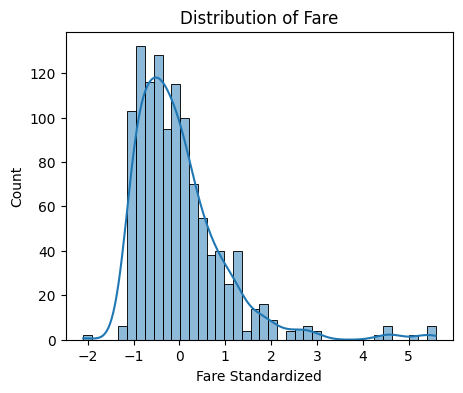

In [18]:
# Create a histogram with KDE
plt.figure(figsize=(5, 4))
sns.histplot(data=y_std, kde=True)
plt.title('Distribution of Fare')
plt.xlabel('Fare Standardized')
plt.ylabel('Count')

plt.show()

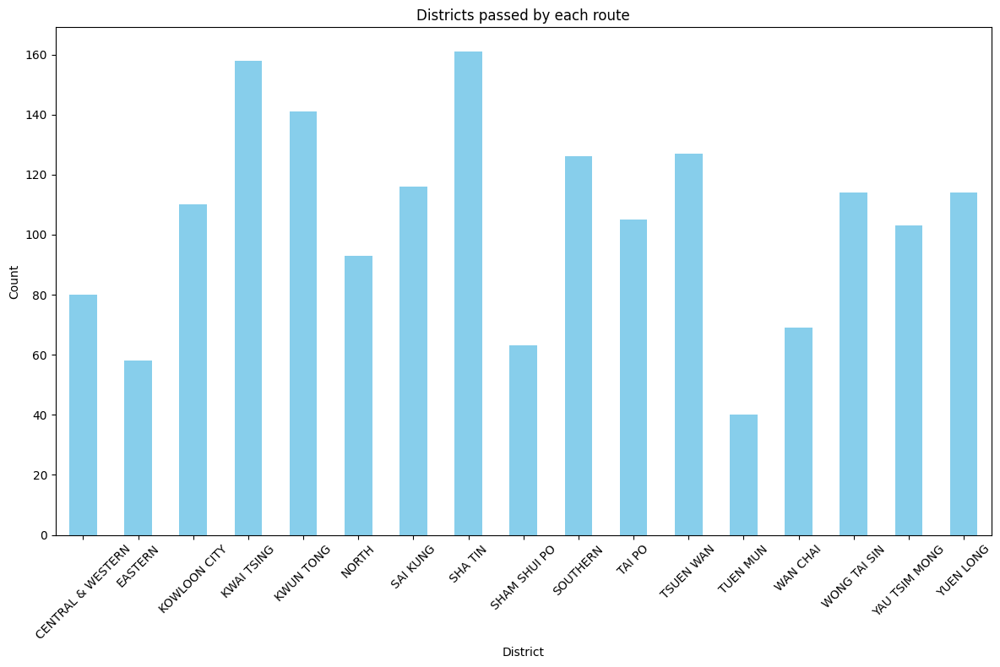

In [19]:
# Assuming 'bus_routes' is your DataFrame
district_counts = gmb_routes.filter(like='district_').sum()

# Convert the result to a Series with district names as index
district_counts.index = [col.replace('district_', '') for col in district_counts.index]

# Create a bar chart
plt.figure(figsize=(12, 8))
district_counts.plot(kind='bar', color='skyblue')

# Add labels and title
plt.xlabel('District')
plt.ylabel('Count')
plt.title('Districts passed by each route')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


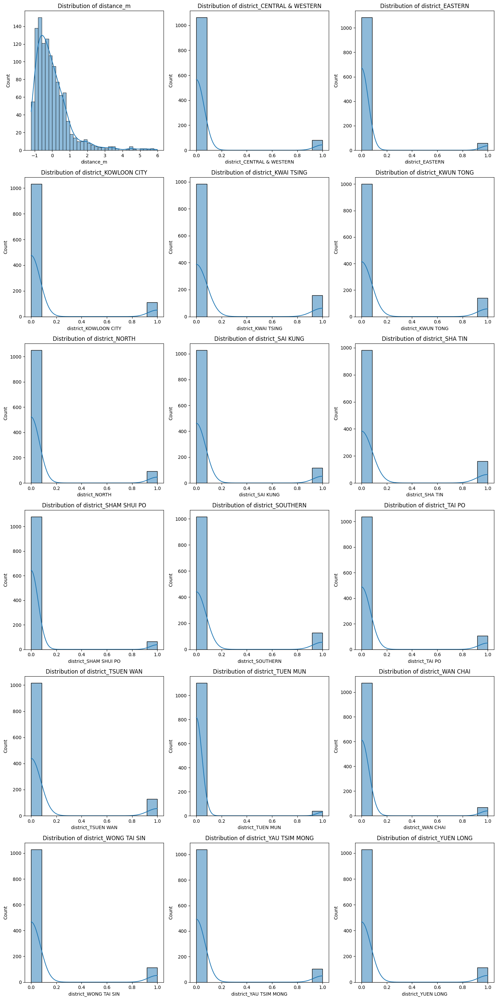

In [20]:
# Distribution plots for each feature in X
def plot_distributions(X):
    n_features = X.shape[1]
    n_cols = 3
    n_rows = (n_features + n_cols - 1) // n_cols

    plt.figure(figsize=(15, 5*n_rows))
    for i in range(n_features):
        plt.subplot(n_rows, n_cols, i+1)
        sns.histplot(data=X.iloc[:,i], kde=True)
        plt.title(f'Distribution of {X.columns[i]}')
    plt.tight_layout()
    plt.show()
# Generate all plots
plot_distributions(X_std.rename(rename_dict, axis=1))

<Figure size 2500x2500 with 0 Axes>

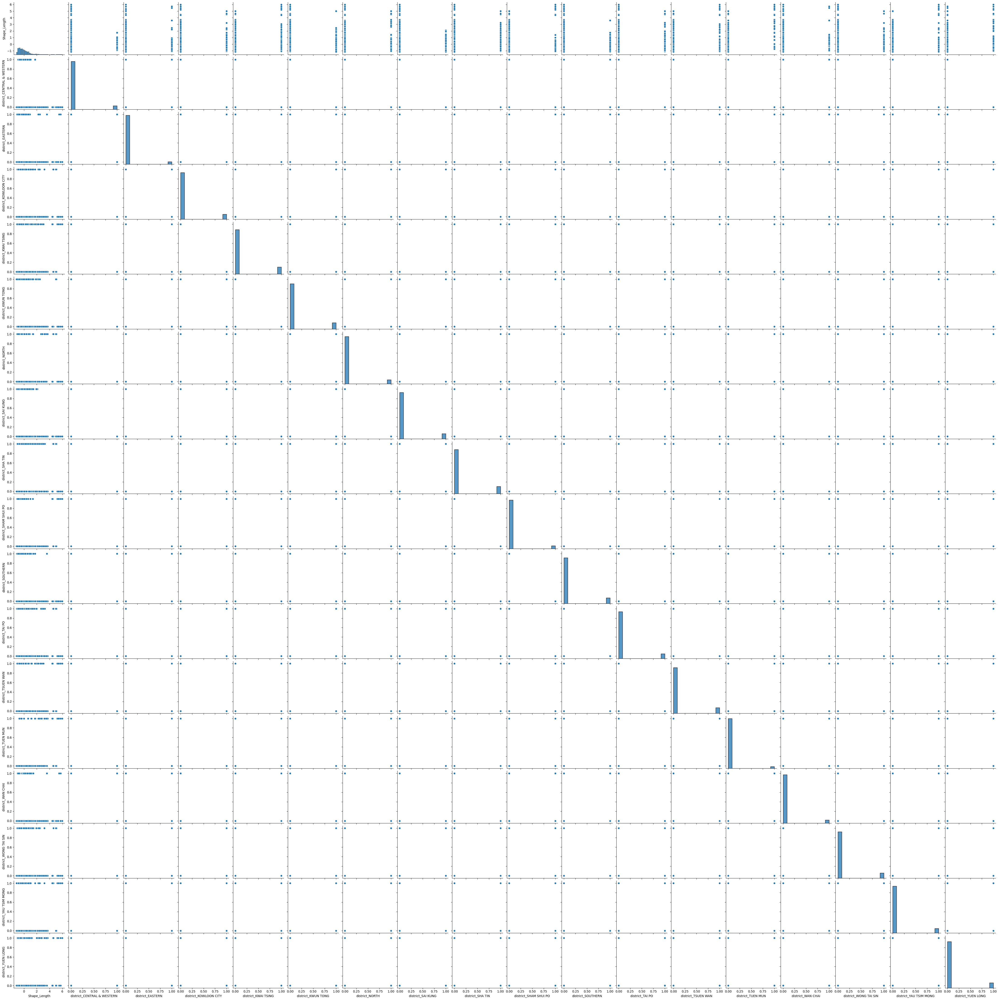

In [21]:
# Scatter plot matrix
def plot_scatter_matrix(X):
    plt.figure(figsize=(25, 25))
    sns.pairplot(X)
    plt.show()
plot_scatter_matrix(X_std)

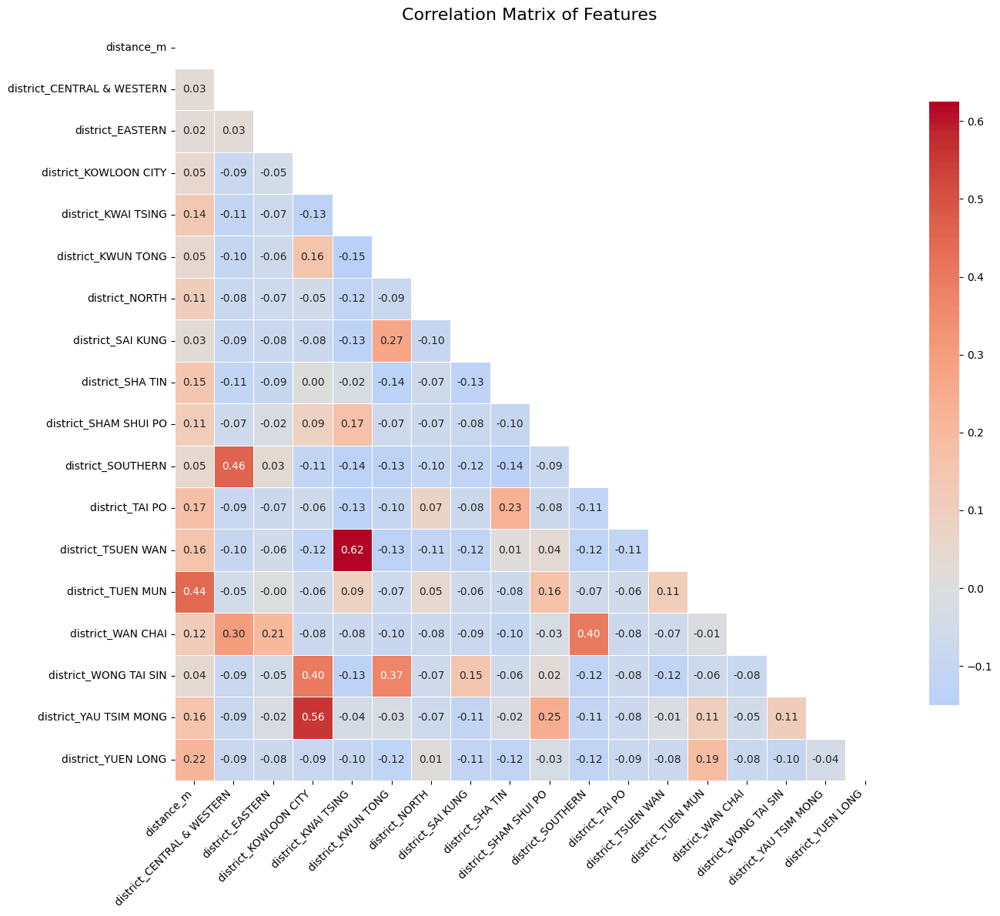

In [22]:
def plot_correlation_heatmap(X, title='Correlation Matrix of Features'):
    """
    Generates and displays a clean, professional correlation heatmap.

    Args:
        X (pd.DataFrame): The input dataframe with numerical features.
        title (str): The title for the plot.
    """
    # 1. Calculate the correlation matrix
    corr_matrix = X.corr()

    # 2. Create a mask to hide the redundant upper triangle
    mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

    # 3. Set up the matplotlib figure with an appropriate size for a 15x15 matrix
    plt.figure(figsize=(14, 12))

    # 4. Generate the heatmap with best practices
    sns.heatmap(
        corr_matrix,
        mask=mask,
        annot=True,
        fmt=".2f",
        cmap='coolwarm',        # Use a diverging colormap (Red/Blue)
        center=0,
        linewidths=.5,
        cbar_kws={"shrink": .8}
    )

    # 5. Add title and adjust labels for readability
    plt.title(title, fontsize=16)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

plot_correlation_heatmap(X_std.rename(rename_dict, axis=1))

In [23]:
# Compute VIF for each feature
X_vif = X_std.copy()


vif_data = pd.DataFrame()
vif_data["Feature"] = X_vif.columns
vif_data["VIF"] = [variance_inflation_factor(X_vif.values, i) for i in range(len(X_vif.columns))]

print(vif_data)

                       Feature       VIF
0                 Shape_Length  1.347670
1   district_CENTRAL & WESTERN  1.382288
2             district_EASTERN  1.073425
3        district_KOWLOON CITY  2.007489
4          district_KWAI TSING  1.924441
5           district_KWUN TONG  1.369874
6               district_NORTH  1.043812
7            district_SAI KUNG  1.168805
8             district_SHA TIN  1.163293
9        district_SHAM SHUI PO  1.198986
10           district_SOUTHERN  1.522270
11             district_TAI PO  1.160881
12          district_TSUEN WAN  1.868155
13           district_TUEN MUN  1.356092
14           district_WAN CHAI  1.374777
15       district_WONG TAI SIN  1.521553
16      district_YAU TSIM MONG  1.770035
17          district_YUEN LONG  1.080986


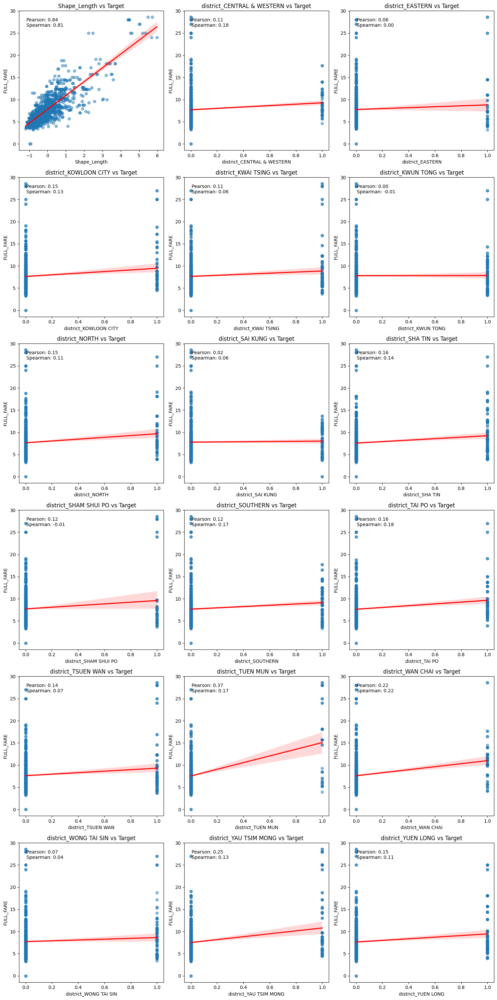

In [24]:
def plot_regression_plots(X, y):
    n_features = X.shape[1]
    n_cols = 3
    n_rows = (n_features + n_cols - 1) // n_cols

    plt.figure(figsize=(15, 5*n_rows))
    for i in range(n_features):
        plt.subplot(n_rows, n_cols, i+1)
        sns.regplot(x=X.iloc[:,i], y=y, scatter_kws={'alpha':0.5}, line_kws={'color': 'red'})
        plt.title(f'{X.columns[i]} vs Target')

        # Calculate both Pearson and Spearman correlations
        pearson_corr = np.corrcoef(X.iloc[:,i], y)[0,1]
        spearman_corr = spearmanr(X.iloc[:,i], y)[0]

        # Add correlation coefficients
        plt.text(0.05, 0.95, f'Pearson: {pearson_corr:.2f}\nSpearman: {spearman_corr:.2f}',
                transform=plt.gca().transAxes,
                verticalalignment='top')
    plt.tight_layout()
    plt.show()

# Generate regression plots
plot_regression_plots(X_std, y)

### **Modelling**

#### Finding optimal number of k-folds

In [25]:
# Code given for reference

# def analyze_grid_search_folds(X, y, param_grid, n_folds=10):
#     # Run grid search
#     grid_search = GridSearchCV(
#         ElasticNet(random_state=42),
#         param_grid,
#         cv=n_folds,
#         scoring='neg_mean_squared_error',
#         n_jobs=-1,
#         return_train_score=True  # Important for fold analysis
#     )

#     start_time = time()
#     grid_search.fit(X, y)
#     total_time = time() - start_time

#     # Get results
#     results = pd.DataFrame(grid_search.cv_results_)

#     # Analyze fold performance
#     fold_scores = []
#     for fold in range(n_folds):
#         fold_scores.append({
#             'fold': fold + 1,
#             'mean_rmse': np.sqrt(-results[f'split{fold}_test_score'].mean()),
#             'std_rmse': results[f'split{fold}_test_score'].std(),
#             'best_rmse': np.sqrt(-results[f'split{fold}_test_score'].max()),
#             'worst_rmse': np.sqrt(-results[f'split{fold}_test_score'].min())
#         })

#     fold_df = pd.DataFrame(fold_scores)

#     # Plotting
#     fig, axes = plt.subplots(2, 2, figsize=(15, 10))

#     # Mean RMSE by fold
#     axes[0,0].bar(fold_df['fold'], fold_df['mean_rmse'])
#     axes[0,0].set_title('Mean RMSE by Fold')
#     axes[0,0].set_ylabel('RMSE')

#     # Best vs Worst RMSE by fold
#     axes[0,1].plot(fold_df['fold'], fold_df['best_rmse'], 'g-', label='Best')
#     axes[0,1].plot(fold_df['fold'], fold_df['worst_rmse'], 'r-', label='Worst')
#     axes[0,1].set_title('Best/Worst RMSE by Fold')
#     axes[0,1].legend()

#     # Distribution of scores across all parameters
#     for fold in range(n_folds):
#         axes[1,0].hist(np.sqrt(-results[f'split{fold}_test_score']),
#                       alpha=0.3, label=f'Fold {fold+1}')
#     axes[1,0].set_title('Distribution of RMSE Across Parameters')
#     axes[1,0].legend()

#     # Variance between folds
#     fold_variance = np.sqrt(-results[[f'split{i}_test_score' for i in range(n_folds)]]).std(axis=1)
#     axes[1,1].hist(fold_variance, bins=50)
#     axes[1,1].set_title('Variance Between Folds')

#     plt.tight_layout()
#     plt.show()

#     # Print summary statistics
#     print("\nFold Performance Summary:")
#     print(fold_df.round(4))

#     print("\nOverall Statistics:")
#     print(f"Best overall RMSE: {np.sqrt(-grid_search.best_score_):.4f}")
#     print(f"Parameters tested: {len(results)}")
#     print(f"Time taken: {total_time:.2f} seconds")

#     print("\nFold Stability Metrics:")
#     print(f"Max difference between folds: {fold_df['mean_rmse'].max() - fold_df['mean_rmse'].min():.4f}")
#     print(f"Std of fold means: {fold_df['mean_rmse'].std():.4f}")

#     # Recommendations
#     print("\nRecommendations:")
#     if fold_df['mean_rmse'].std() > 0.1:
#         print("⚠️ High variation between folds - consider different CV strategy")
#     if fold_variance.mean() > 0.1:
#         print("⚠️ Parameters show high sensitivity to fold selection")

#     # Best parameters analysis
#     best_params = grid_search.best_params_
#     print("\nBest Parameters Performance by Fold:")
#     best_idx = results['rank_test_score'] == 1
#     for fold in range(n_folds):
#         fold_score = np.sqrt(-results.loc[best_idx, f'split{fold}_test_score'].iloc[0])
#         print(f"Fold {fold+1}: RMSE = {fold_score:.4f}")

# # Run analysis
# param_grid = {
#     'alpha': np.logspace(-5, 3, 20),  # 20 points from 1e-5 to 1e3
#     'l1_ratio': np.linspace(0, 1, 20),  # 20 points from 0 to 1
#     'max_iter': [1000, 2000, 5000],
#     'tol': [1e-5, 1e-4, 1e-3]
# }
# analyze_grid_search_folds(X_std, y, param_grid, n_folds=15)

In [26]:
# Code given for reference

# def analyze_fold_overfitting(X, y, param_grid, fold_numbers=[3, 5, 10, 15, 20]):
#     results = []

#     for n_folds in fold_numbers:
#         # Run grid search
#         grid_search = GridSearchCV(
#             ElasticNet(random_state=42),
#             param_grid,
#             cv=n_folds,
#             scoring='neg_mean_squared_error',
#             n_jobs=-1,
#             return_train_score=True
#         )

#         grid_search.fit(X, y)

#         # Get best model
#         best_model = grid_search.best_estimator_

#         # Calculate learning curves
#         train_sizes, train_scores, val_scores = learning_curve(
#             best_model, X, y,
#             cv=n_folds,
#             scoring='neg_mean_squared_error',
#             train_sizes=np.linspace(0.1, 1.0, 10),
#             n_jobs=-1
#         )

#         # Convert MSE to RMSE
#         train_rmse = np.sqrt(-train_scores).mean(axis=1)
#         val_rmse = np.sqrt(-val_scores).mean(axis=1)

#         results.append({
#             'n_folds': n_folds,
#             'train_sizes': train_sizes,
#             'train_rmse': train_rmse,
#             'val_rmse': val_rmse,
#             'gap': np.mean(val_rmse - train_rmse),
#             'best_score': np.sqrt(-grid_search.best_score_),
#             'train_test_gap': np.sqrt(-grid_search.best_score_) -
#                              np.sqrt(-grid_search.cv_results_['mean_train_score'][grid_search.best_index_])
#         })

#     # Plotting
#     fig, axes = plt.subplots(2, 2, figsize=(15, 12))

#     # Learning curves for each fold
#     for result in results:
#         axes[0,0].plot(result['train_sizes'], result['train_rmse'],
#                       '--', label=f'{result["n_folds"]}-fold (train)')
#         axes[0,0].plot(result['train_sizes'], result['val_rmse'],
#                       '-', label=f'{result["n_folds"]}-fold (val)')
#     axes[0,0].set_title('Learning Curves by Number of Folds')
#     axes[0,0].set_xlabel('Training Examples')
#     axes[0,0].set_ylabel('RMSE')
#     axes[0,0].legend()

#     # Train-validation gap
#     fold_numbers = [r['n_folds'] for r in results]
#     gaps = [r['gap'] for r in results]
#     axes[0,1].plot(fold_numbers, gaps, 'o-')
#     axes[0,1].set_title('Average Train-Validation Gap')
#     axes[0,1].set_xlabel('Number of Folds')
#     axes[0,1].set_ylabel('Gap (RMSE)')

#     # Best scores
#     best_scores = [r['best_score'] for r in results]
#     axes[1,0].plot(fold_numbers, best_scores, 'o-')
#     axes[1,0].set_title('Best Cross-Validation Score')
#     axes[1,0].set_xlabel('Number of Folds')
#     axes[1,0].set_ylabel('RMSE')

#     # Train-test gap for best model
#     train_test_gaps = [r['train_test_gap'] for r in results]
#     axes[1,1].plot(fold_numbers, train_test_gaps, 'o-')
#     axes[1,1].set_title('Train-Test Gap for Best Model')
#     axes[1,1].set_xlabel('Number of Folds')
#     axes[1,1].set_ylabel('Gap (RMSE)')

#     plt.tight_layout()
#     plt.show()

#     # Print analysis
#     print("\nOverfitting Analysis:")
#     for result in results:
#         print(f"\n{result['n_folds']}-fold CV:")
#         print(f"Average train-val gap: {result['gap']:.4f}")
#         print(f"Best CV score (RMSE): {result['best_score']:.4f}")
#         print(f"Train-test gap: {result['train_test_gap']:.4f}")

#     # Recommendations
#     print("\nRecommendations:")
#     min_gap_folds = fold_numbers[np.argmin(gaps)]
#     print(f"Optimal folds for minimizing overfitting: {min_gap_folds}")

#     if min_gap_folds < 5:
#         print("Warning: Very low number of folds might lead to unstable estimates")
#     elif min_gap_folds > 15:
#         print("Warning: High number of folds might be computationally expensive")

# # Run analysis
# analyze_fold_overfitting(X, y, param_grid)

#### Hyperparameter tuning (Same code for Model evaluation ElasticNet/Lasso/Ridge optimisation)

In [27]:
# Code given for reference

# # Basic ElasticNet
# elastic = ElasticNet(
#     alpha=0.023357,      # Overall regularization strength
#     l1_ratio=1.000000,   # Mix between L1 and L2 (0 = Ridge, 1 = Lasso)
#     max_iter=1000,
#     tol=0.000010,
#     random_state=42
# )

# # Grid Search for both parameters
# param_grid = {
#     'alpha': np.logspace(-5, 3, 20),  # 20 points from 1e-5 to 1e3
#     'l1_ratio': np.linspace(0, 1, 20),  # 20 points from 0 to 1
#     'max_iter': [1000, 2000, 5000],
#     'tol': [1e-5, 1e-4, 1e-3]
# }

# param_grid = {
#     'alpha': np.logspace(-5, 3, 20),  # 20 points from 1e-5 to 1e3
#     'l1_ratio': np.linspace(0, 1, 20),  # 20 points from 0 to 1
#     'max_iter': [20000],
#     'tol': [1e-5, 1e-4, 1e-3, 1e-2]
# }

# grid_search = GridSearchCV(
#     ElasticNet(random_state=42),
#     param_grid,
#     cv=4,
#     scoring='neg_mean_squared_error',
#     n_jobs=-1
# )

# # Fit and get results
# grid_search.fit(X_std, y)

# print("Best parameters:", grid_search.best_params_)
# print("Best score:", np.sqrt(-grid_search.best_score_))  # RMSE

# # Use best model
# best_model = grid_search.best_estimator_

# # Feature importance
# feature_importance = pd.DataFrame({
#     'Feature': X_std.columns,
#     'Coefficient': best_model.coef_
# })
# print("\nFeature Coefficients:")
# print(feature_importance.sort_values('Coefficient', key=abs, ascending=False))

In [28]:
# Code given for reference

# # Convert GridSearchCV results to DataFrame
# results = pd.DataFrame(grid_search.cv_results_)

# # Create top 15 with initial processing
# top_15 = results.sort_values('mean_test_score', ascending=False)
# top_15_df = pd.DataFrame([
#     {
#         'alpha': p['alpha'],
#         'l1_ratio': p['l1_ratio'],
#         'max_iter': p['max_iter'],
#         'tol': p['tol'],
#         'RMSE': np.sqrt(-score),
#         'Std Dev': std
#     }
#     for p, score, std in zip(top_15['params'],
#                             top_15['mean_test_score'],
#                             top_15['std_test_score'])
# ])

# # Round RMSE to 5 decimal places for grouping
# top_15_df['RMSE_rounded'] = top_15_df['RMSE'].round(4)

# # Get the best combination (lowest std dev) for each unique RMSE
# unique_combinations = (top_15_df
#     .sort_values('Std Dev', ascending=True)  # Sort by std dev within each group
#     .groupby('RMSE_rounded')
#     .first()  # Take the first (lowest std dev) combination
#     .reset_index()
#     .sort_values('RMSE_rounded', ascending=True) # Sort by RMSE
#     )

# # Additional Analysis
# print("\nSummary Statistics for Unique Combinations:")
# print(f"Number of unique RMSE values (5 d.p.): {len(unique_combinations)}")
# print("\nParameter Ranges for Best Combinations:")
# print(f"Alpha range: {unique_combinations['alpha'].min():.2e} to {unique_combinations['alpha'].max():.2e}")
# print(f"L1 ratio range: {unique_combinations['l1_ratio'].min():.4f} to {unique_combinations['l1_ratio'].max():.4f}")
# print(f"Std Dev range: {unique_combinations['Std Dev'].min():.5f} to {unique_combinations['Std Dev'].max():.5f}")

# # Display top combinations sorted by RMSE
# print("\nBest Parameter Combinations (Sorted by Lowest RMSE):")
# print(unique_combinations[['RMSE_rounded', 'Std Dev', 'alpha', 'l1_ratio']].head(50).round(5))

#### OLS model

                            WLS Regression Results                            
Dep. Variable:              FULL_FARE   R-squared:                       0.797
Model:                            WLS   Adj. R-squared:                  0.794
Method:                 Least Squares   F-statistic:                     245.0
Date:                Wed, 15 Oct 2025   Prob (F-statistic):               0.00
Time:                        07:11:08   Log-Likelihood:                -2212.2
No. Observations:                1143   AIC:                             4462.
Df Residuals:                    1124   BIC:                             4558.
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                                 coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const               

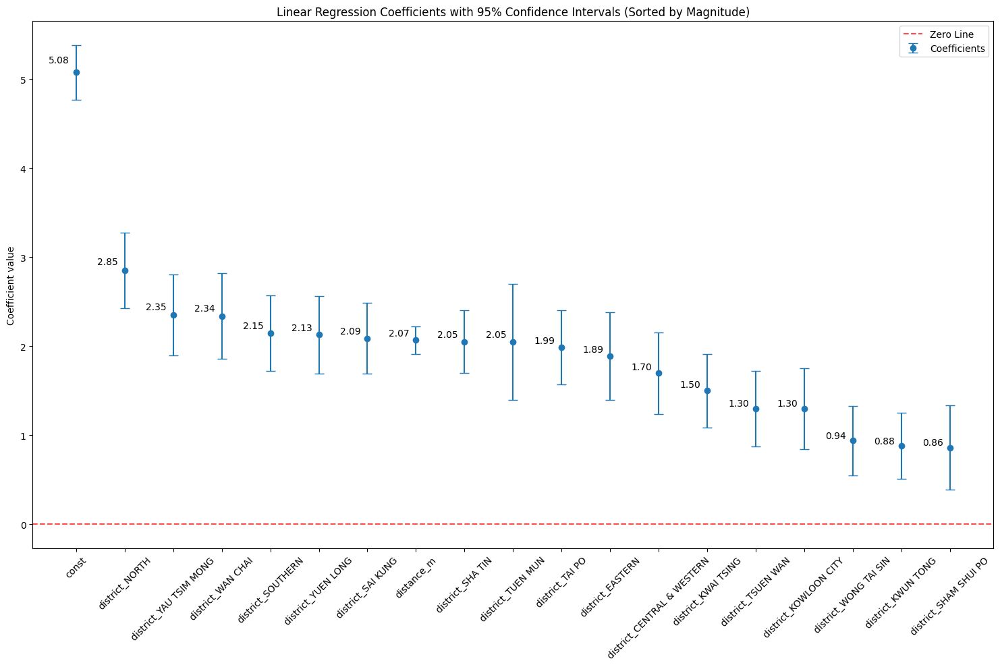

In [29]:
# Add a constant column for the intercept
X_with_const = sm.add_constant(X_std)

# Fit the OLS model
model = sm.OLS(y, X_with_const).fit()
model = sm.WLS(y, X_with_const, ).fit()

# Print the summary which includes confidence intervals
print(model.summary())

# Access confidence intervals directly
conf_int = model.conf_int(alpha=0.05)  # 95% confidence intervals
print("\nConfidence Intervals (95%):")
for i, var in enumerate(['const'] + [f'X{j+1}' for j in range(X_std.shape[1])]):
    # Fix: Use proper pandas DataFrame indexing
    print(f"{var}: [{conf_int.iloc[i, 0]:.4f}, {conf_int.iloc[i, 1]:.4f}]")


def plot_coefficients(model):
    coefs = model.params
    conf_int = model.conf_int()

    coefs = coefs
    conf_int = conf_int
    # Sort coefficients by absolute value
    sorted_idx = coefs.abs().sort_values(ascending=False).index
    coefs = coefs[sorted_idx]
    conf_int = conf_int.loc[sorted_idx]
    var_names = coefs.rename(rename_dict, axis=0).index  # Update variable names to match sorted order

    plt.figure(figsize=(15, 10))

    # Convert to numpy arrays for plotting
    coefs_array = coefs.values
    lower_bounds = conf_int.iloc[:, 0].values
    upper_bounds = conf_int.iloc[:, 1].values

    # Plot the error bars
    plt.errorbar(range(len(coefs)), coefs_array,
                 yerr=[coefs_array - lower_bounds, upper_bounds - coefs_array],
                 fmt='o', capsize=5, label='Coefficients')

    # Add coefficient values as text annotations
    for i, val in enumerate(coefs_array):
        # Format the coefficient value to 2 decimal places
        formatted_val = f'{val:.2f}'
        # Adjust the horizontal position slightly to the left
        plt.text(i - 0.35, val + 0.02 * max(abs(lower_bounds[i]), abs(upper_bounds[i])),
                 formatted_val, ha='center', fontsize=10)

    # Add reference line at zero
    plt.axhline(y=0, color='r', linestyle='--', alpha=0.7, label='Zero Line')


    # Add axis labels and title
    plt.xticks(range(len(coefs)), var_names, rotation=45)
    plt.ylabel('Coefficient value')
    plt.title('Linear Regression Coefficients with 95% Confidence Intervals (Sorted by Magnitude)')
    plt.legend(loc='upper right')
    plt.tight_layout()
    plt.show()

# Call the function to visualize coefficients
plot_coefficients(model)

### **Model Evaluation**

#### Model tuning

##### XGBoost

In [30]:
# Code given for reference

# # Basic XGBoost
# xgb = XGBRegressor(
#     n_estimators=100,
#     max_depth=3,
#     learning_rate=0.05,
#     subsample=0.8,
#     colsample_bytree=0.8,
#     tree_method='hist',
#     random_state=42
# )

# # Parameter grid for small dataset with binary features
# param_grid_xgb = {
#     'n_estimators': [100, 200],
#     'max_depth': [2, 3, 4],          # shallow trees for binary features
#     'learning_rate': [0.01, 0.05, 0.1],
#     'min_child_weight': [1, 3],      # helps with binary features
#     'subsample': [0.8, 1.0],         # sampling ratio
#     'colsample_bytree': [0.8, 1.0]   # feature sampling
# }

# # Grid Search
# grid_search = GridSearchCV(
#     XGBRegressor(random_state=42, tree_method='hist'),
#     param_grid_xgb,
#     cv=4,
#     scoring='neg_mean_squared_error',
#     n_jobs=-1,
#     verbose=2
# )

# # Fit and get results
# grid_search.fit(X_std, y)

# print("Best parameters:", grid_search.best_params_)
# print("Best score:", np.sqrt(-grid_search.best_score_))  # RMSE

# # Use best model
# best_model = grid_search.best_estimator_

# # Feature importance
# feature_importance = pd.DataFrame({
#     'Feature': X_std.columns,
#     'Importance': best_model.feature_importances_
# })
# print("\nFeature Importance:")
# print(feature_importance.sort_values('Importance', ascending=False))

# # Additional performance metrics
# y_pred = best_model.predict(X_std)
# r2 = best_model.score(X_std, y)
# print("\nR-squared:", r2)

# # Convert GridSearchCV results to DataFrame for detailed analysis
# results = pd.DataFrame(grid_search.cv_results_)

# # Create top combinations with initial processing
# top_df = pd.DataFrame([
#     {
#         'n_estimators': p['n_estimators'],
#         'max_depth': p['max_depth'],
#         'learning_rate': p['learning_rate'],
#         'min_child_weight': p['min_child_weight'],
#         'subsample': p['subsample'],
#         'colsample_bytree': p['colsample_bytree'],
#         'RMSE': np.sqrt(-score),
#         'Std Dev': std
#     }
#     for p, score, std in zip(results['params'],
#                             results['mean_test_score'],
#                             results['std_test_score'])
# ])

# # Round RMSE for grouping
# top_df['RMSE_rounded'] = top_df['RMSE'].round(4)

# # Get the best combination (lowest std dev) for each unique RMSE
# unique_combinations = (top_df
#     .sort_values('Std Dev', ascending=True)
#     .groupby('RMSE_rounded')
#     .first()
#     .reset_index()
#     .sort_values('RMSE_rounded', ascending=True)
# )

# # Display top combinations
# print("\nBest Parameter Combinations (Sorted by Lowest RMSE):")
# display_columns = ['RMSE_rounded', 'Std Dev', 'n_estimators', 'max_depth',
#                   'learning_rate', 'min_child_weight', 'subsample', 'colsample_bytree']
# print(unique_combinations[display_columns].head(50).round(5))

In [31]:
# Code given for reference

# # Convert GridSearchCV results to DataFrame
# results = pd.DataFrame(grid_search.cv_results_)

# # Create top combinations with initial processing
# top_df = pd.DataFrame([
#     {
#         'n_estimators': p['n_estimators'],
#         'max_depth': p['max_depth'],
#         'learning_rate': p['learning_rate'],
#         'subsample': p['subsample'],
#         'colsample_bytree': p['colsample_bytree'],
#         'RMSE': np.sqrt(-score),
#         'Std Dev': std
#     }
#     for p, score, std in zip(results['params'],
#                             results['mean_test_score'],
#                             results['std_test_score'])
# ])

# # Round RMSE for grouping
# top_df['RMSE_rounded'] = top_df['RMSE'].round(4)

# # Get the best combination (lowest std dev) for each unique RMSE
# unique_combinations = (top_df
#     .sort_values('Std Dev', ascending=True)
#     .groupby('RMSE_rounded')
#     .first()
#     .reset_index()
#     .sort_values('RMSE_rounded', ascending=True)
# )

# # Summary Statistics
# print("\nSummary Statistics for Unique Combinations:")
# print(f"Number of unique RMSE values (4 d.p.): {len(unique_combinations)}")
# print("\nParameter Ranges for Best Combinations:")
# print(f"n_estimators range: {unique_combinations['n_estimators'].min()} to {unique_combinations['n_estimators'].max()}")
# print(f"max_depth range: {unique_combinations['max_depth'].min()} to {unique_combinations['max_depth'].max()}")
# print(f"learning_rate range: {unique_combinations['learning_rate'].min():.3f} to {unique_combinations['learning_rate'].max():.3f}")
# print(f"subsample range: {unique_combinations['subsample'].min():.2f} to {unique_combinations['subsample'].max():.2f}")
# print(f"colsample_bytree range: {unique_combinations['colsample_bytree'].min():.2f} to {unique_combinations['colsample_bytree'].max():.2f}")
# print(f"Std Dev range: {unique_combinations['Std Dev'].min():.5f} to {unique_combinations['Std Dev'].max():.5f}")

# # Display top combinations
# print("\nBest Parameter Combinations (Sorted by Lowest RMSE):")
# display_columns = ['RMSE_rounded', 'Std Dev', 'n_estimators', 'max_depth',
#                   'learning_rate', 'subsample', 'colsample_bytree']
# print(unique_combinations[display_columns].head(50).round(5))

# # Feature importance for best model
# best_model = grid_search.best_estimator_
# print("\nFeature Importance for Best Model:")
# feature_importance = pd.DataFrame({
#     'Feature': X_std.columns,
#     'Importance': best_model.feature_importances_
# })
# print(feature_importance.sort_values('Importance', ascending=False))

##### Random Forest

In [32]:
# Code given for reference

# # Basic RandomForest
# rf = RandomForestRegressor(
#     n_estimators=100,
#     max_depth=None,
#     min_samples_split=2,
#     min_samples_leaf=1,
#     max_features='auto',
#     random_state=42
# )

# # Comprehensive parameter grid
# param_grid_rf = {
#     'n_estimators': [100, 200, 500],  # more would be overkill
#     'max_depth': [None, 6, 8, 10],    # deeper trees risk overfitting
#     'min_samples_split': [2, 5, 10],  # ~1%, 0.5%, 1% of data
#     'min_samples_leaf': [1, 3, 5],    # prevent too-small leaves
#     'max_features': ['sqrt', 'log2', 0.33]  # sqrt(18)≈4, log2(18)≈4, 6 features
# }

# # Grid Search
# grid_search = GridSearchCV(
#     RandomForestRegressor(random_state=42),
#     param_grid_rf,
#     cv=4,
#     scoring='neg_mean_squared_error',
#     n_jobs=-1,
#     verbose=2
# )

# # Fit and get results
# grid_search.fit(X_std, y)

# print("Best parameters:", grid_search.best_params_)
# print("Best score:", np.sqrt(-grid_search.best_score_))  # RMSE

# # Use best model
# best_model = grid_search.best_estimator_

# # Feature importance
# feature_importance = pd.DataFrame({
#     'Feature': X_std.columns,
#     'Importance': best_model.feature_importances_
# })
# print("\nFeature Importance:")
# print(feature_importance.sort_values('Importance', ascending=False))

# # Additional performance metrics
# y_pred = best_model.predict(X_std)
# r2 = best_model.score(X_std, y)
# print("\nR-squared:", r2)

In [33]:
# Code given for reference

# # Convert GridSearchCV results to DataFrame
# results = pd.DataFrame(grid_search.cv_results_)

# # Create top combinations with initial processing
# top_df = pd.DataFrame([
#     {
#         'n_estimators': p['n_estimators'],
#         'max_depth': p['max_depth'],
#         'min_samples_split': p['min_samples_split'],
#         'min_samples_leaf': p['min_samples_leaf'],
#         'max_features': p['max_features'],
#         'RMSE': np.sqrt(-score),
#         'Std Dev': std
#     }
#     for p, score, std in zip(results['params'],
#                             results['mean_test_score'],
#                             results['std_test_score'])
# ])

# # Round RMSE for grouping
# top_df['RMSE_rounded'] = top_df['RMSE'].round(4)

# # Get the best combination (lowest std dev) for each unique RMSE
# unique_combinations = (top_df
#     .sort_values('Std Dev', ascending=True)
#     .groupby('RMSE_rounded')
#     .first()
#     .reset_index()
#     .sort_values('RMSE_rounded', ascending=True)
# )

# # Summary Statistics
# print("\nSummary Statistics for Unique Combinations:")
# print(f"Number of unique RMSE values (4 d.p.): {len(unique_combinations)}")
# print("\nParameter Ranges for Best Combinations:")
# print(f"n_estimators range: {unique_combinations['n_estimators'].min()} to {unique_combinations['n_estimators'].max()}")
# print(f"max_depth range: {unique_combinations['max_depth'].min()} to {unique_combinations['max_depth'].max()}")
# print(f"min_samples_split range: {unique_combinations['min_samples_split'].min()} to {unique_combinations['min_samples_split'].max()}")
# print(f"Std Dev range: {unique_combinations['Std Dev'].min():.5f} to {unique_combinations['Std Dev'].max():.5f}")

# # Display top combinations
# print("\nBest Parameter Combinations (Sorted by Lowest RMSE):")
# display_columns = ['RMSE_rounded', 'Std Dev', 'n_estimators', 'max_depth',
#                   'min_samples_split', 'min_samples_leaf', 'max_features']
# print(unique_combinations[display_columns].head(50).round(5))

# # Optional: Feature importance for best model
# best_params = unique_combinations.iloc[0]
# print("\nFeature Importance for Best Model:")
# feature_importance = pd.DataFrame({
#     'Feature': X_std.columns,
#     'Importance': best_model.feature_importances_
# })
# print(feature_importance.sort_values('Importance', ascending=False))

#### Optimal models

In [34]:
X_std = np.asarray(X_std)
y = np.asarray(y)

ols = LinearRegression()

ridge = ElasticNet(
    alpha=0.00336,
    l1_ratio=0,
    max_iter=20000,
    tol=0.0000100,
    random_state=42
)

lasso = ElasticNet(
    alpha=0.000010,
    l1_ratio=1,
    max_iter=20000,
    tol=0.000010,
    random_state=42
)

elastic = ElasticNet(
    alpha=0.001274,
    l1_ratio=0.315789,
    max_iter=20000,
    tol=0.010000,
    random_state=42
)

rf = RandomForestRegressor(
    n_estimators=100,
    max_depth=None,
    min_samples_split=2,
    min_samples_leaf=1,
    max_features='sqrt',
    random_state=42
)

xgb = XGBRegressor(
    n_estimators=200,
    max_depth=2,
    learning_rate=0.1,
    subsample=1.0,
    colsample_bytree=0.8,
    tree_method='hist',
    random_state=42
)

/usr/local/lib/python3.12/dist-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.243e+03, tolerance: 1.196e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/usr/local/lib/python3.12/dist-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.210e+03, tolerance: 1.068e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_mode


Average metrics across folds:
                 RMSE      R2     MAE
Model                                
Elastic Net    1.7149  0.7834  1.2670
Lasso          1.7138  0.7836  1.2707
OLS            1.7138  0.7836  1.2707
Random Forest  1.5709  0.8165  1.1103
Ridge          1.7210  0.7818  1.2641
XGBoost        1.6513  0.7986  1.2094

Standard deviation of metrics across folds:
                 RMSE      R2     MAE
Model                                
Elastic Net    0.1459  0.0181  0.0739
Lasso          0.1453  0.0179  0.0718
OLS            0.1453  0.0179  0.0718
Random Forest  0.1161  0.0296  0.0746
Ridge          0.1470  0.0188  0.0773
XGBoost        0.1284  0.0213  0.0893

Model ranking by RMSE (lower is better):
                 RMSE      R2     MAE
Model                                
Random Forest  1.5709  0.8165  1.1103
XGBoost        1.6513  0.7986  1.2094
OLS            1.7138  0.7836  1.2707
Lasso          1.7138  0.7836  1.2707
Elastic Net    1.7149  0.7834  1.2670


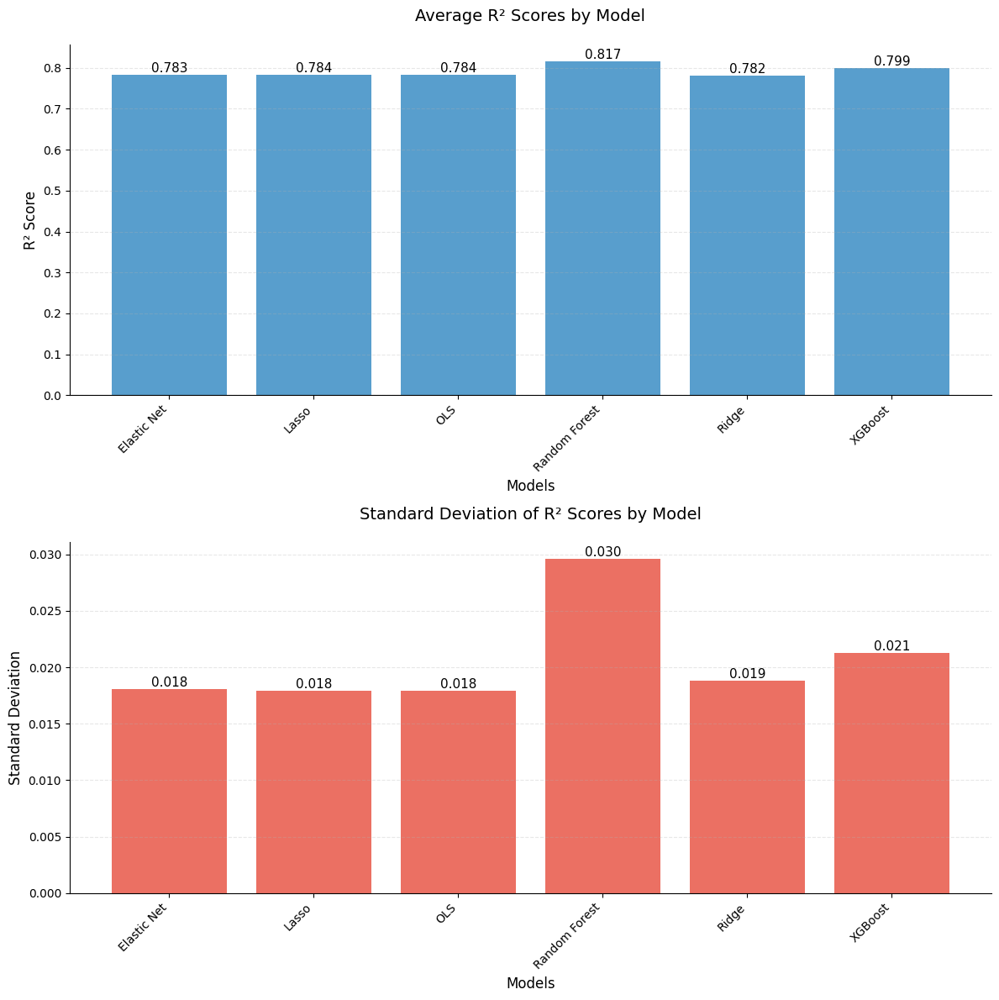

In [35]:
# Initialize models in a dictionary
models = {
    'OLS': ols,
    'Ridge': ridge,
    'Lasso': lasso,
    'Elastic Net': elastic,
    'Random Forest': rf,
    'XGBoost': xgb
}

# Initialize KFold
kf = KFold(n_splits=4, shuffle=True, random_state=42)

# Dictionary to store results
results = {
    'Model': [],
    'Fold': [],
    'RMSE': [],
    'R2': [],
    'MAE': []
}

# Perform cross-validation
for model_name, model in models.items():
    fold = 1
    for train_idx, val_idx in kf.split(X_std):
        try:
            # Split the data
            X_train = X_std[train_idx]
            X_val = X_std[val_idx]
            y_train = y[train_idx]
            y_val = y[val_idx]

            # Fit model
            try:
                model.fit(X_train, y_train)
                y_pred = model.predict(X_val)
            except Exception as e:
                print(f"Error fitting {model_name} on fold {fold}: {e}")
            except Exception as e:
                print(f"Error predicting with {model_name} on fold {fold}: {e}")
                continue

            # Calculate metrics
            rmse = np.sqrt(mean_squared_error(y_val, y_pred))
            r2 = r2_score(y_val, y_pred)
            mae = mean_absolute_error(y_val, y_pred)

            # Store results
            results['Model'].append(model_name)
            results['Fold'].append(fold)
            results['RMSE'].append(rmse)
            results['R2'].append(r2)
            results['MAE'].append(mae)

            fold += 1

        except Exception as e:
            print(f"Error processing fold {fold} for {model_name}: {e}")
            continue

results_df = pd.DataFrame(results)
# Calculate average metrics for each model
avg_results = results_df.groupby('Model').agg({
    'RMSE': 'mean',
    'R2': 'mean',
    'MAE': 'mean'
}).round(4)
print("\nAverage metrics across folds:")
print(avg_results)
# Calculate standard deviation of metrics
std_results = results_df.groupby('Model').agg({
    'RMSE': 'std',
    'R2': 'std',
    'MAE': 'std'
}).round(4)
print("\nStandard deviation of metrics across folds:")
print(std_results)
# Rank models based on RMSE (lower is better)
print("\nModel ranking by RMSE (lower is better):")
print(avg_results.sort_values('RMSE').head())


def plot_model_comparison(avg_results, std_results):
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 12))

    models = avg_results.index
    x_pos = np.arange(len(models))

    bars1 = ax1.bar(x_pos, avg_results['R2'], color='#2E86C1', alpha=0.8)

    ax1.set_title('Average R² Scores by Model', fontsize=14, pad=20)
    ax1.set_xlabel('Models', fontsize=12)
    ax1.set_ylabel('R² Score', fontsize=12)
    ax1.set_xticks(x_pos)
    ax1.set_xticklabels(models, rotation=45, ha='right')
    ax1.grid(True, axis='y', linestyle='--', alpha=0.3)
    ax1.spines['top'].set_visible(False)
    ax1.spines['right'].set_visible(False)

    for bar in bars1:
        height = bar.get_height()
        ax1.text(bar.get_x() + bar.get_width()/2., height,
                f'{height:.3f}',
                ha='center', va='bottom', fontsize=11)

    bars2 = ax2.bar(x_pos, std_results['R2'], color='#E74C3C', alpha=0.8)

    ax2.set_title('Standard Deviation of R² Scores by Model', fontsize=14, pad=20)
    ax2.set_xlabel('Models', fontsize=12)
    ax2.set_ylabel('Standard Deviation', fontsize=12)
    ax2.set_xticks(x_pos)
    ax2.set_xticklabels(models, rotation=45, ha='right')
    ax2.grid(True, axis='y', linestyle='--', alpha=0.3)
    ax2.spines['top'].set_visible(False)
    ax2.spines['right'].set_visible(False)

    for bar in bars2:
        height = bar.get_height()
        ax2.text(bar.get_x() + bar.get_width()/2., height,
                f'{height:.3f}',
                ha='center', va='bottom', fontsize=11)

    plt.tight_layout()
    plt.show()


plot_model_comparison(avg_results, std_results)

/usr/local/lib/python3.12/dist-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.710e+03, tolerance: 1.581e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(



Final results:
           Model    RMSE      R2     MAE
0            OLS  1.6761  0.7969  1.2386
1          Ridge  1.6839  0.7950  1.2337
2          Lasso  1.6761  0.7969  1.2386
3    Elastic Net  1.6773  0.7966  1.2355
4  Random Forest  0.5789  0.9758  0.3983
5        XGBoost  1.4337  0.8514  1.0757


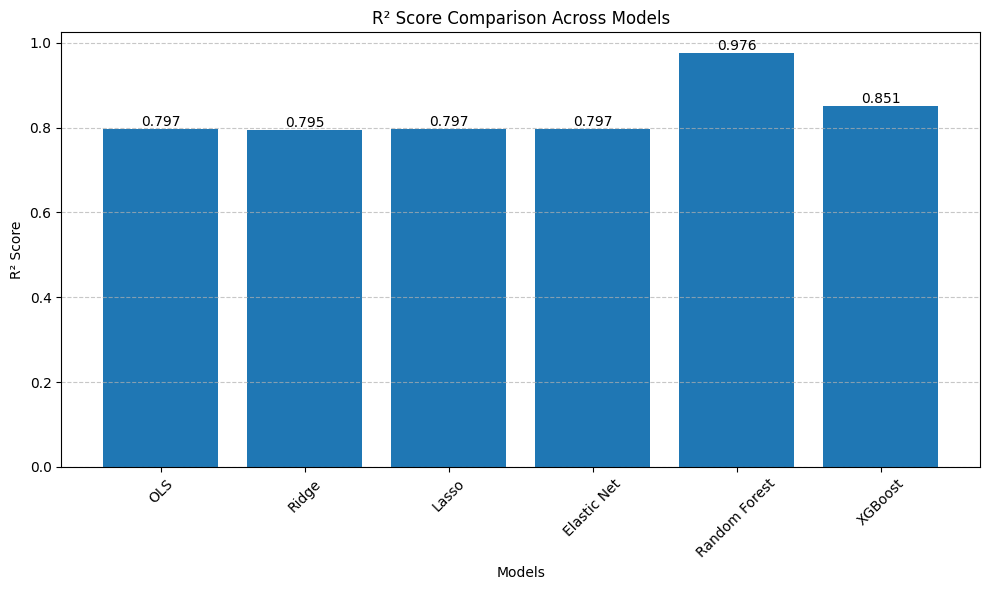


Model ranking by R2 (higher is better):
           Model      R2    RMSE     MAE
4  Random Forest  0.9758  0.5789  0.3983
5        XGBoost  0.8514  1.4337  1.0757
0            OLS  0.7969  1.6761  1.2386
2          Lasso  0.7969  1.6761  1.2386
3    Elastic Net  0.7966  1.6773  1.2355
1          Ridge  0.7950  1.6839  1.2337


In [36]:
# Dictionary to store results
results = {
    'Model': [],
    'RMSE': [],
    'R2': [],
    'MAE': []
}

# Calculate metrics for each model
for model_name, model in models.items():

    # Fit model
    model.fit(X_std, y)

    # Make predictions
    y_pred = model.predict(X_std)

    # Calculate metrics
    rmse = np.sqrt(mean_squared_error(y, y_pred))
    r2 = r2_score(y, y_pred)
    mae = mean_absolute_error(y, y_pred)

    # Store results
    results['Model'].append(model_name)
    results['RMSE'].append(rmse)
    results['R2'].append(r2)
    results['MAE'].append(mae)

# Convert to DataFrame and display results
results_df = pd.DataFrame(results)
print("\nFinal results:")
print(results_df.round(4))

# Create bar plot for R2 scores
plt.figure(figsize=(10, 6))
bars = plt.bar(results_df['Model'], results_df['R2'])
plt.title('R² Score Comparison Across Models')
plt.xlabel('Models')
plt.ylabel('R² Score')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Add value labels on top of each bar
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{height:.3f}',
             ha='center', va='bottom')

plt.tight_layout()
plt.show()

# Rank models based on R2
print("\nModel ranking by R2 (higher is better):")
print(results_df.sort_values('R2', ascending=False)[['Model', 'R2', 'RMSE', 'MAE']].round(4))

### **Interpretability**

Linear Models
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                 OLS     Ridge     Lasso  Elastic Net  \
district_KWUN TONG          0.879100  0.617044  0.878539     0.774321   
district_SHAM SHUI PO       0.863239  0.693144  0.862776     0.792217   
district_WONG TAI SIN       0.939897  0.821334  0.939644     0.893997   
district_TSUEN WAN          1.298363  1.096974  1.297926     1.219753   
district_KOWLOON CITY       1.296676  1.171523  1.296374     1.245917   
district_KWAI TSING         1.500502  1.204639  1.499941     1.385433   
district_CENTRAL & WESTERN  1.696587  1.467081  1.696105     1.606961   
district_EASTERN            1.890497  1.525743  1.889764     1.747817   
district_TAI PO             1.986770  1.600876  1.986003     1.836277   
district_TUEN MUN           2.049760  1.556440  2.04879

<Figure size 1200x1200 with 0 Axes>

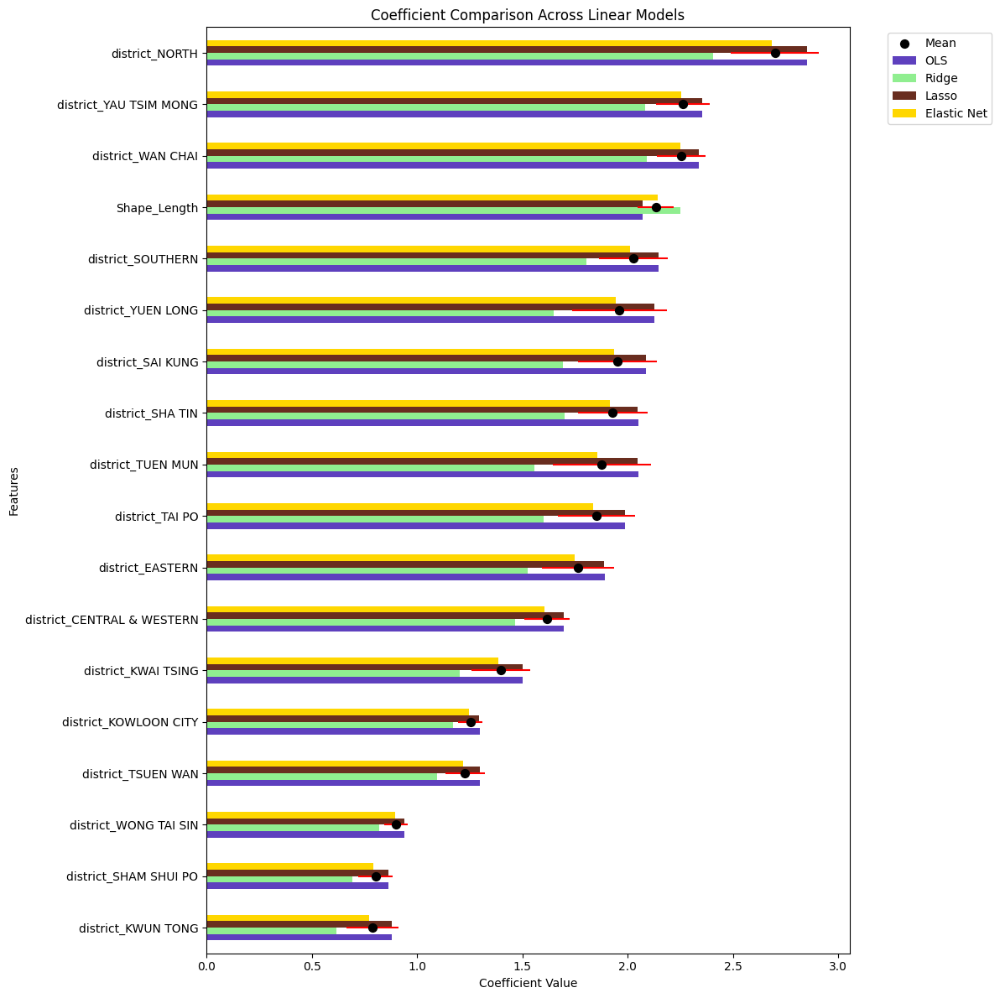



Tree Models
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                            Random Forest   XGBoost      Mean
district_SAI KUNG                0.010023  0.005014  0.007519
district_YUEN LONG               0.016920  0.005104  0.011012
district_WONG TAI SIN            0.017425  0.004785  0.011105
district_CENTRAL & WESTERN       0.010706  0.011723  0.011214
district_EASTERN                 0.016888  0.010532  0.013710
district_SOUTHERN                0.017291  0.011139  0.014215
district_TAI PO                  0.021597  0.009595  0.015596
district_KWAI TSING              0.023869  0.008367  0.016118
district_TSUEN WAN               0.023028  0.014333  0.018680
district_KOWLOON CITY            0.022205  0.020837  0.021521
district_NORTH                   0.030644  0.013985  0.022314
district_KWUN TONG               0.011679

<Figure size 1200x800 with 0 Axes>

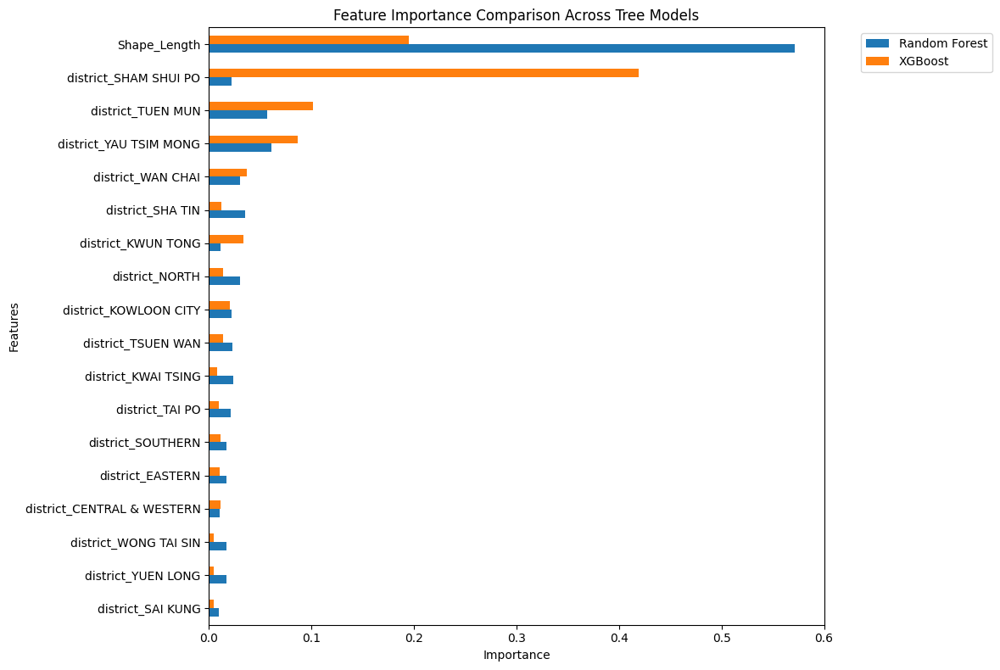

In [37]:
def plot_linear_coefficients(models_dict, feature_names, top_n=20):
  plt.figure(figsize=(12, 12))

  # Create DataFrame with coefficients from all models
  coef_dict = {}
  for name, model in models_dict.items():
      if name in ['OLS', 'Ridge', 'Lasso', 'Elastic Net']:
          coef_dict[name] = model.coef_

  coef_df = pd.DataFrame(coef_dict, index=feature_names)
  coef_df['Mean'] = coef_df.mean(axis=1)
  coef_df['Std'] = coef_df[['OLS', 'Ridge', 'Lasso', 'Elastic Net']].std(axis=1)

  # Sort by absolute mean of coefficients
  coef_df = coef_df.reindex(coef_df.abs()['Mean'].sort_values(ascending=True).index)
  coef_df = coef_df.tail(top_n)

  print(coef_df)
  # Create the plot without the mean first
  ax = coef_df[['OLS', 'Ridge', 'Lasso', 'Elastic Net']].plot(kind='barh', figsize=(12, 12),
                   color={'OLS': '#5E40BE',          # bright red
                         'Ridge': '#90EE90',         # bright light green
                         'Lasso': '#692D1F',         # brown
                         'Elastic Net': '#FFD700'})  # gold

  # Add error bars
  y_pos = range(len(coef_df.index))
  plt.hlines(y=y_pos,
            xmin=coef_df['Mean'] - coef_df['Std'],
            xmax=coef_df['Mean'] + coef_df['Std'],
            color='red', alpha=1, zorder=5)

  # Add mean line on top
  plt.scatter(coef_df['Mean'], y_pos, color='black', zorder=6, label='Mean', s=50)
  # plt.plot(coef_df['Mean'], y_pos, color='black', zorder=6, linewidth=2)

  plt.subplots_adjust(left=0.3)
  plt.title('Coefficient Comparison Across Linear Models')
  plt.xlabel('Coefficient Value')
  plt.ylabel('Features')
  plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
  plt.tight_layout()
  plt.show()


# For Tree-based Models
def plot_tree_importance(models_dict, feature_names, top_n=20):
    plt.figure(figsize=(12, 8))

    # Create DataFrame with feature importance from tree models
    importance_dict = {}
    for name, model in models_dict.items():
        if name in ['Random Forest', 'XGBoost']:
            importance_dict[name] = model.feature_importances_

    importance_df = pd.DataFrame(importance_dict, index=feature_names)

    # Add mean column
    importance_df['Mean'] = importance_df.mean(axis=1)

    # Sort by absolute mean of importance
    importance_df = importance_df.reindex(importance_df.abs()['Mean'].sort_values(ascending=True).index)

    # Take top N features
    importance_df = importance_df.tail(top_n)

    print(importance_df)
    importance_df = importance_df.drop('Mean', axis=1)
    # Plot
    importance_df.plot(kind='barh', figsize=(12, 8))
    plt.title('Feature Importance Comparison Across Tree Models')
    plt.xlabel('Importance')
    plt.ylabel('Features')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()


print("Linear Models")
print('-'*200)
plot_linear_coefficients(models, feature_names)
print("\n\nTree Models")
print('-'*200)
plot_tree_importance(models, feature_names)


Coefficients and Z-Scores:
                                Mean   Z_Score
district_NORTH              2.699498  1.839895
district_YAU TSIM MONG      2.261959  1.030055
district_WAN CHAI           2.255535  1.018165
Shape_Length                2.133458  0.792211
district_SOUTHERN           2.027530  0.596149
district_YUEN LONG          1.961791  0.474473
district_SAI KUNG           1.952062  0.456465
district_SHA TIN            1.928563  0.412972
district_TUEN MUN           1.877651  0.318738
district_TAI PO             1.852481  0.272152
district_EASTERN            1.763455  0.107373
district_CENTRAL & WESTERN  1.616683 -0.164287
district_KWAI TSING         1.397629 -0.569734
district_KOWLOON CITY       1.252623 -0.838126
district_TSUEN WAN          1.228254 -0.883230
district_WONG TAI SIN       0.898718 -1.493168
district_SHAM SHUI PO       0.802844 -1.670621
district_KWUN TONG          0.787251 -1.699482




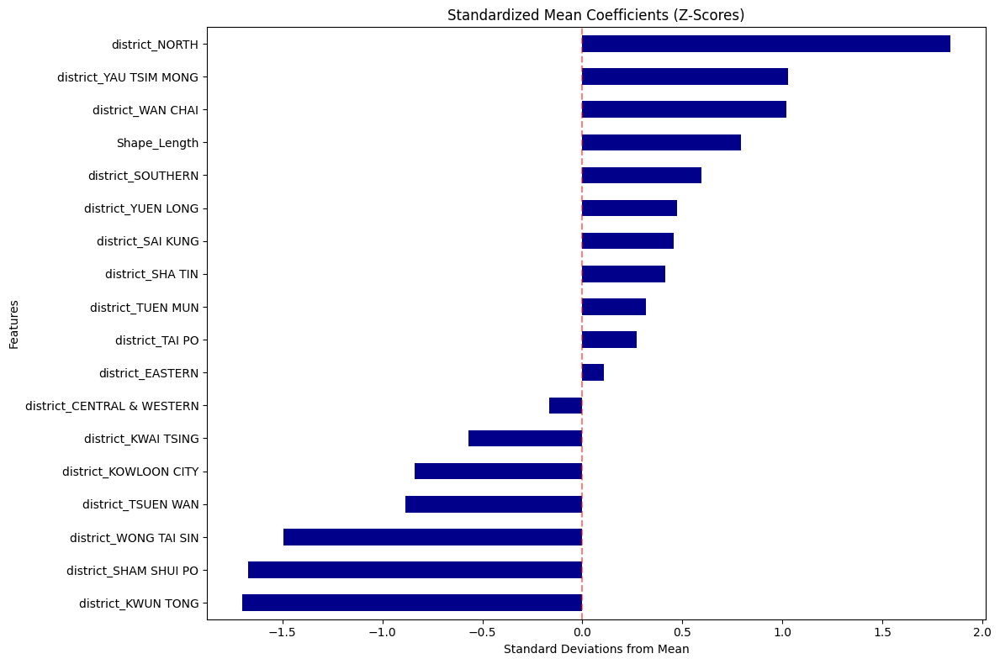

In [38]:
# For Linear Models
def plot_linear_coefficients_with_standardized(models_dict, feature_names, top_n=20):
    # First plot (original)
    plt.figure(figsize=(12, 8))

    # Create DataFrame with coefficients from all models
    coef_dict = {}
    for name, model in models_dict.items():
        if name in ['OLS', 'Ridge', 'Lasso', 'Elastic Net']:
            coef_dict[name] = model.coef_

    coef_df = pd.DataFrame(coef_dict, index=feature_names)
    coef_df['Mean'] = coef_df.mean(axis=1)
    coef_df['Std'] = coef_df[['OLS', 'Ridge', 'Lasso', 'Elastic Net']].std(axis=1)

    # Calculate z-score for mean coefficients
    coef_df['Z_Score'] = (coef_df['Mean'] - coef_df['Mean'].mean()) / coef_df['Mean'].std()

    # Sort by absolute mean of coefficients
    coef_df = coef_df.reindex(coef_df.abs()['Mean'].sort_values(ascending=True).index)
    coef_df = coef_df.tail(top_n)

    print("\nCoefficients and Z-Scores:")
    print(coef_df[['Mean', 'Z_Score']].sort_values(by='Z_Score', ascending=False))
    print("\n")

    coef_df['Z_Score'].plot(kind='barh', color='darkblue')
    plt.axvline(x=0, color='red', linestyle='--', alpha=0.5)
    plt.title('Standardized Mean Coefficients (Z-Scores)')
    plt.xlabel('Standard Deviations from Mean')
    plt.ylabel('Features')
    plt.subplots_adjust(left=0.3)
    plt.tight_layout()
    plt.show()

    return coef_df

coef_df = plot_linear_coefficients_with_standardized(models, feature_names)